<h3> <b>Single-cell and spatial transcriptomics validation tutorial</b> </h3>

This tutorial is the end-to-end pipeline to validate any markers to have more understanding of the complex biology of cancer progression
It is part of the study "Uncovering breast cancer metabolic landscape through multi-modal machine learning and metabolic modelling"

This tutorial include two main section for user to explore single-cell and spatial transcriptomics analyses

Section I: Single-cell analysis

Section II: Transcriptomic analysis



<h3> Before starting </h3>
Please install the below libraries (scanpy and scvi-tools) and restart the kernel

In [1]:
!pip install scanpy
!pip install scvi-tools
!pip install palantir
!pip install leidenalg

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 28.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.4/124.4 kB 10.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.9/56.9 kB 3.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.7/85.7 kB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.8/79.8 kB 7.5 MB/s eta 0:00:00
  Created wheel for session-info: filename=session_info-1.0.0-py3-none-any.whl size=8023 sha256=fe34702fe24c7a8a1e0153b9ee02c51af42e4f73e55200966c3f627852ea5d9e
  Stored in directory: /root/.cache/pip/wheels/6a/aa/b9/eb5d4031476ec10802795b97ccf937b9bd998d68a9b268765a
Successfully built session-info
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.2/57.2 kB 3.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.9/77.9 kB 6.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Using cached nvidia_cud

<h3> Step 1: Load libraries and data

In [2]:
"""Step 1.1 Import the libraries"""
import scanpy as sc
import scvi
# from scvi.data import register_tensor_from_anndata
from scvi.external import RNAStereoscope, SpatialStereoscope
import palantir
import igraph
print(igraph.__version__)


import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from google.colab import drive
drive.mount('/content/drive')

0.11.6
Mounted at /content/drive


In [ ]:
# Version log
# sc.logging.print_versions()
# sc.set_figure_params(facecolor="white", figsize=(8, 8))
# sc.settings.verbosity = 3

<h3> <b> Section I: Single-cell analysis </b> </h3>

Note: We provide a few options to load raw counts of single-cell data (h5ad or matrix).
To fasten the loading process, after this step, all of the preprocessed data will saved to h5ad, which contain the preprocessed information, clustering,...

In [ ]:
"""Step 1.2 Load your scRNA-seq data and marker genes"""

path = "/content/drive/MyDrive/BC_Multiomics_Integration/"


# Loading expression counts and signature gene sets
# if the user want to use the raw matrix data it would take a while (10 min)
#  We provide the option to load h5 object -raw count to speed up the loading process
adata = sc.read_h5ad(path+'Preprocessed_data/Raw_count.h5ad')
# adata = sc.read_10x_mtx(path+'sc_BC_data/' )


# Loading  metadata(cell type and breast cancer subtypes or any single-cell meta data)
meta = pd.read_csv(path+'sc_BC_data/metadata.csv', skiprows=0, index_col=0)

# In case the raw matrix was loaded, the user can convert to h5ad to speed up the loading process
adata.write_h5ad(path+'Preprocessed_data/Raw_count.h5ad')

In [ ]:
# Define the parameters (the number of highly variable genes to analyses)
# Default is 500 highly variable genes
n_gene =500
RANDOM_STATE = 42

# Whether to apply MAGIC (Markov Affinity-based Graph Imputation of Cells) algorithm to denoise sc-RNA (True/False)
# We would recommend to use MAGIC to denoise sc-RNA
denoise =True
# Define the method to analyse DE genes. You can choose: 'logreg', 't-test', 'wilcoxon', 't-test_overestim_var'
de_method = "wilcoxon"
# Define the number of DE genes to visualise
de_genes_visualise = 15


# Importing marker list
# The marker list can also defined directly from here
# For example:
gene_list= ['NR4A1','SLC6A12', 'RAB5C','STEAP2',
              'PAK1','PSMA2','ZNF595', 'PAPSS2','N6AMT1',
              'ADORA3','P2RY2','CECR7',
              'DDX10','PTK6','BTG2',
              'DEPDC7','CX3CL1','WAC-AS1',
              'ZNF516','WDR55','C17orf58',
              'CAPN11','SPDEF','EIF3D','WNT3']

# gene_list = pd.read_csv(path+'gene_list.csv', index_col=0)



In [ ]:
#  Have a quick overview of the scRNA-seq data.
adata

AnnData object with n_obs × n_vars = 100064 × 29733
    var: 'gene_ids', 'feature_types'

<h4> Step 2: Quality control and preprocess the scRNA-seq data

In [ ]:
"""Step 2.1 Quality control"""

#  We save the raw counts to a new layers for future analysis
adata.layers['counts'] = adata.X.copy()

# Quality control
# mitochondrial genes
adata.var["mt"] = adata.var_names.str.startswith("MT-")
# ribosomal genes
adata.var["ribo"] = adata.var_names.str.startswith(("RPS", "RPL"))
# hemoglobin genes.
adata.var["hb"] = adata.var_names.str.contains(("^HB[^(P)]"))

# Create quality control metrics
sc.pp.calculate_qc_metrics(
    adata, qc_vars=["mt", "ribo", "hb"], inplace=True, percent_top=[20], log1p=True
)
adata

AnnData object with n_obs × n_vars = 100064 × 29733
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb'
    var: 'gene_ids', 'feature_types', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    layers: 'counts'

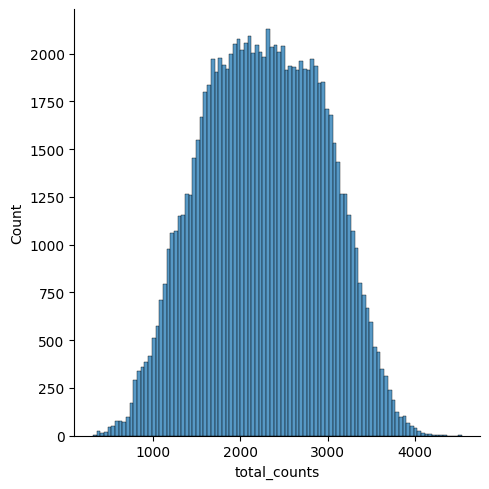

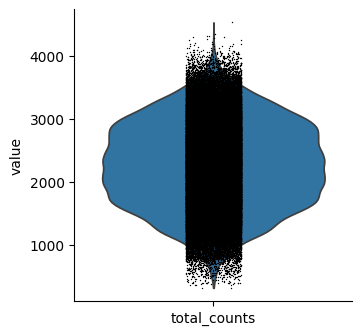

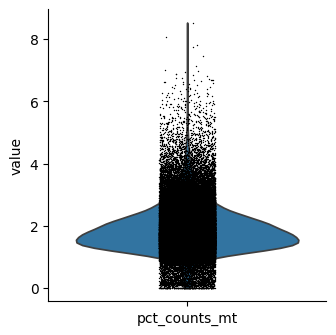

<Figure size 400x400 with 0 Axes>

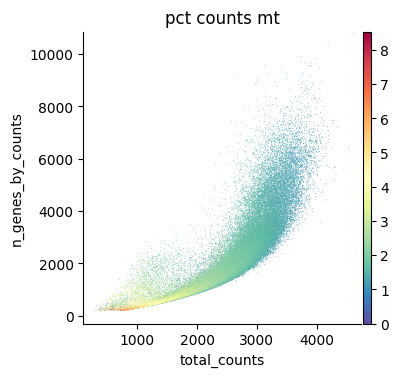

<Figure size 400x400 with 0 Axes>

In [ ]:
"""Step 2.2 Distribution visualisation"""

p1 = sns.displot(adata.obs["total_counts"], bins=100, kde=False)
plt.savefig(path+'Plot/total_count_org.pdf', dpi=300, bbox_inches='tight')
sc.pl.violin(adata, 'total_counts')
p2 = sc.pl.violin(adata, "pct_counts_mt")
plt.savefig(path+'Plot/pct_counts_mt_org.pdf', dpi=300, bbox_inches='tight')
p3 = sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_mt")
plt.savefig(path+'Plot/N_gene_by_count_org.pdf', dpi=300, bbox_inches='tight')

In [ ]:

adata

AnnData object with n_obs × n_vars = 100064 × 29733
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb'
    var: 'gene_ids', 'feature_types', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    layers: 'counts'

In [ ]:
"""Step 2.3 Preprocess """

sc.pp.filter_genes(adata, min_cells = 250)
sc.pp.filter_cells(adata, min_counts = 200)
sc.pp.normalize_total(adata )
sc.pp.log1p(adata)

# Remove cell with less than mito 20%
adata =adata[adata.obs['pct_counts_mt'] <20]

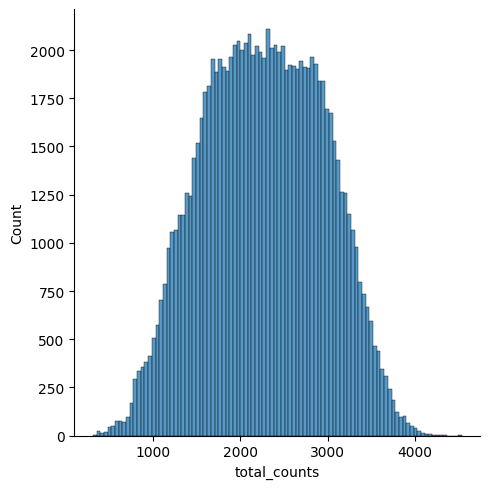

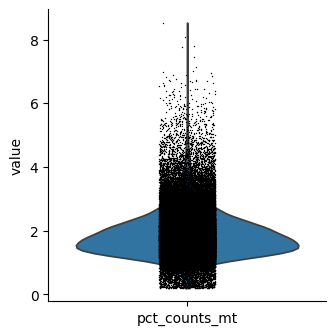

<Figure size 400x400 with 0 Axes>

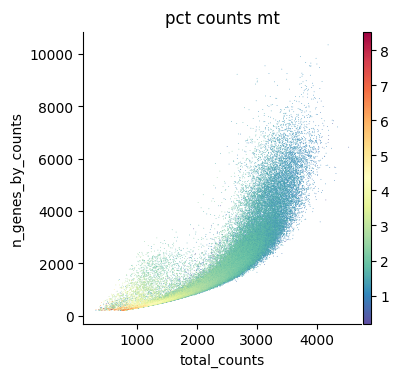

<Figure size 400x400 with 0 Axes>

In [ ]:
#  Visualise the data after preprocessing (optional)
p1 = sns.displot(adata.obs["total_counts"], bins=100, kde=False)
plt.savefig(path+'Plot/total_count_preprocessed.pdf', dpi=300, bbox_inches='tight')
# sc.pl.violin(adata, 'total_counts')
p2 = sc.pl.violin(adata, "pct_counts_mt")
plt.savefig(path+'Plot/pct_counts_mt_preprocessed.pdf', dpi=300, bbox_inches='tight')
p3 = sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_mt")
plt.savefig(path+'Plot/N_gene_by_count_preprocessed.pdf', dpi=300, bbox_inches='tight')

In [ ]:
#  save preprocess data
file_path_sc = 'Preprocessed_data/Sc_preprocessed.h5ad'
adata.write_h5ad(path+file_path_sc)

C:\Users\Le\AppData\Roaming\Python\Python310\site-packages\scanpy\preprocessing\_highly_variable_genes.py:693: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns["hvg"] = {"flavor": flavor}


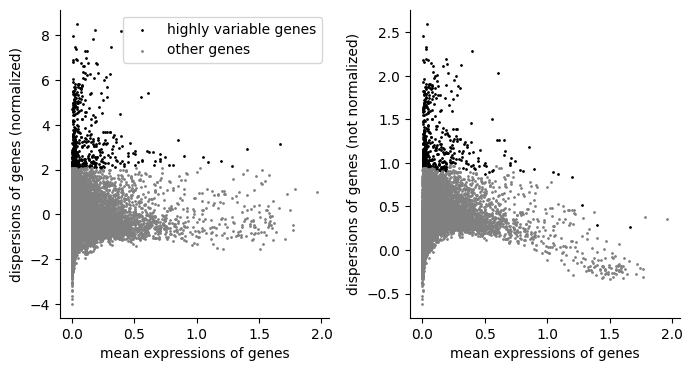

In [ ]:
"""Step 2.4 Preprocess - Select the HVG """

sc.pp.highly_variable_genes(adata, n_top_genes = n_gene)
# Plot HGV
sc.pl.highly_variable_genes(adata, save=f'{n_gene}_HVG.pdf')

# Merge HVGs and Top SHAP genes
merged_genes = adata.var[adata.var["highly_variable"]].index
var_genes_all = adata.var.highly_variable.index.to_list()
final_merged =set(merged_genes) | set(gene_list)

# Please note that not all genes we provided in the single-cell HGV,
# so we need to get the common genes for visualisation and further analysis
gene_list_final = list(set(adata.var.index) & set(gene_list))

In [ ]:
# Reload preprocessed data
# file_path_sc = 'Preprocessed_data/Sc_preprocessed.h5ad'
adata = sc.read_h5ad(path+ file_path_sc)

# Gene selection
adata.var['Selected_gene']  = adata.var.apply(
    lambda row: any(val in final_merged for val in row), axis=1)
adata =adata[:, adata.var['Selected_gene'] ==True]

# Metadata
# adata.obs['nCount_RNA'] = meta['nCount_RNA']

adata.obs['subtype'] = meta['subtype']
adata.obs['celltype_subset'] = meta['celltype_subset']
adata.obs['celltype_minor'] = meta['celltype_minor']
adata.obs['Group'] = meta['celltype_major']

#  Save final preprocessed data
adata.write_h5ad(path+'Preprocessed_data/scBC_500_HGV_SHAP.h5ad')

# Distribution of subtype
print(adata.obs.groupby('subtype').count())

# Distribution of cell-type
print(adata.obs.groupby('Group').count())

C:\Users\Le\AppData\Local\Temp\ipykernel_37128\4013439989.py:13: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['subtype'] = meta['subtype']


         n_genes_by_counts  log1p_n_genes_by_counts  total_counts  \
subtype                                                             
ER+                  38214                    38214         38214   
HER2+                19209                    19209         19209   
TNBC                 41878                    41878         41878   

         log1p_total_counts  pct_counts_in_top_20_genes  total_counts_mt  \
subtype                                                                    
ER+                   38214                       38214            38214   
HER2+                 19209                       19209            19209   
TNBC                  41878                       41878            41878   

         log1p_total_counts_mt  pct_counts_mt  total_counts_ribo  \
subtype                                                            
ER+                      38214          38214              38214   
HER2+                    19209          19209              19209   
T

C:\Users\Le\AppData\Local\Temp\ipykernel_37128\4013439989.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  print(adata.obs.groupby('subtype').count())
C:\Users\Le\AppData\Local\Temp\ipykernel_37128\4013439989.py:25: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  print(adata.obs.groupby('Group').count())


<h3> Step 3: Visualise single-cell

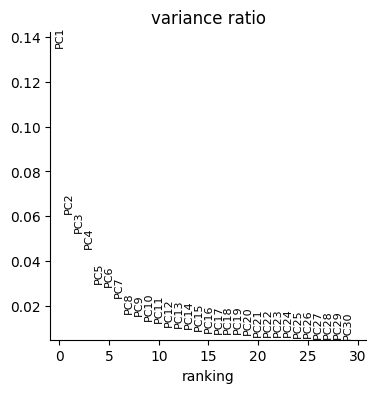

In [ ]:
# 3.1 PCA
sc.tl.pca(adata, svd_solver='arpack', n_comps=30)
sc.pl.pca_variance_ratio(adata, n_pcs = 30)


C:\Users\Le\AppData\Local\Temp\ipykernel_37128\3507583186.py:5: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, random_state=RANDOM_STATE)


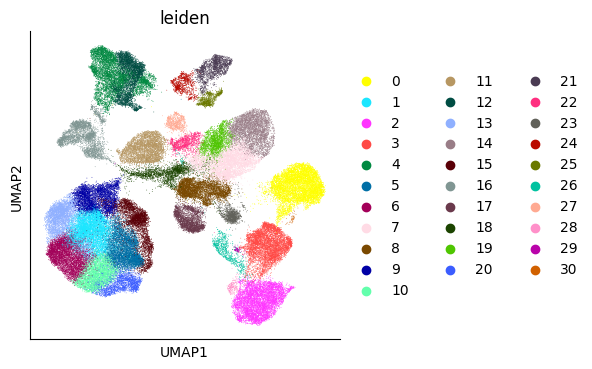

In [ ]:
#  Decide the number of neighbours based on variance ratior plot
sc.pp.neighbors(adata, n_pcs=15)

# Apply leiden algorithms to cluster ( it might take a while - 3-5 min)
sc.tl.leiden(adata, random_state=RANDOM_STATE)
sc.tl.umap(adata)
sc.pl.umap(adata, color='leiden')

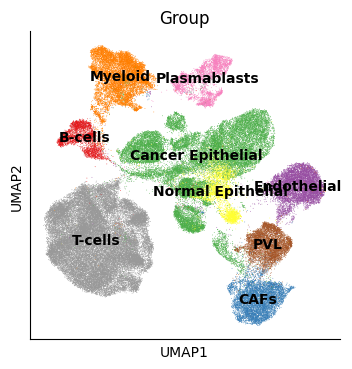

In [ ]:
# 3.2 Cell-type clustering
sc.pl.umap(adata, color=['Group'], legend_loc='on data', palette='Set1',
           save='all_cell_type_legend.png')

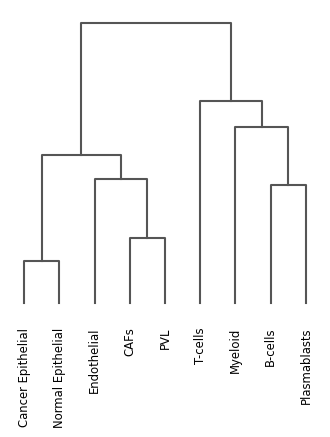

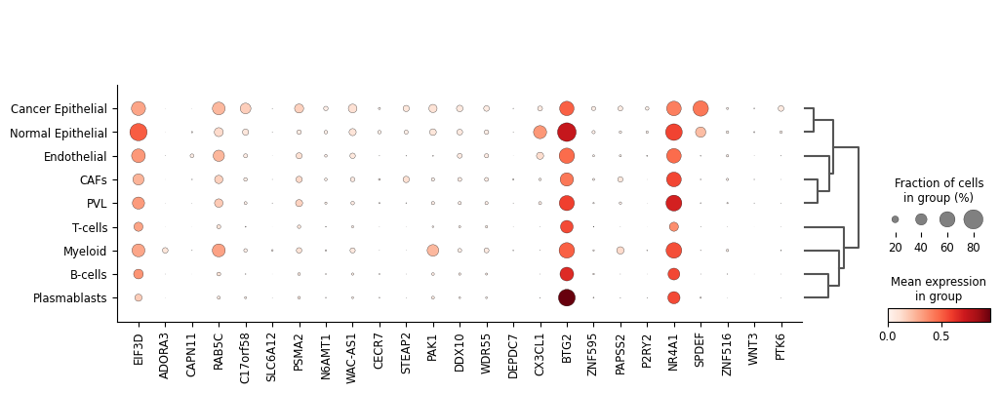

In [ ]:
# 3.2a Cell-type investigation
sc.tl.dendrogram(adata, groupby = ["Group"])
sc.pl.dendrogram(adata, groupby = "Group")

sc.pl.dotplot(adata, gene_list_final, groupby='Group', dendrogram=True,
                save='marker_dendogram_cell_type.pdf')

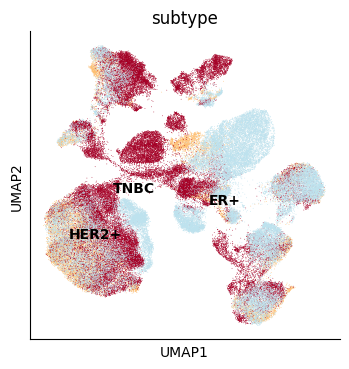

In [ ]:
# 3.3 Breast cancer subtype clustering
subtype_color = ["#BDE2EE", "#FDBf71", "#A50026"]
sc.pl.umap(adata, color=['subtype'], palette=subtype_color, legend_loc='on data',
           save='BC_subtype.png')

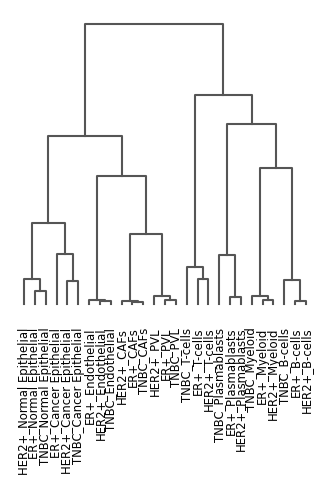

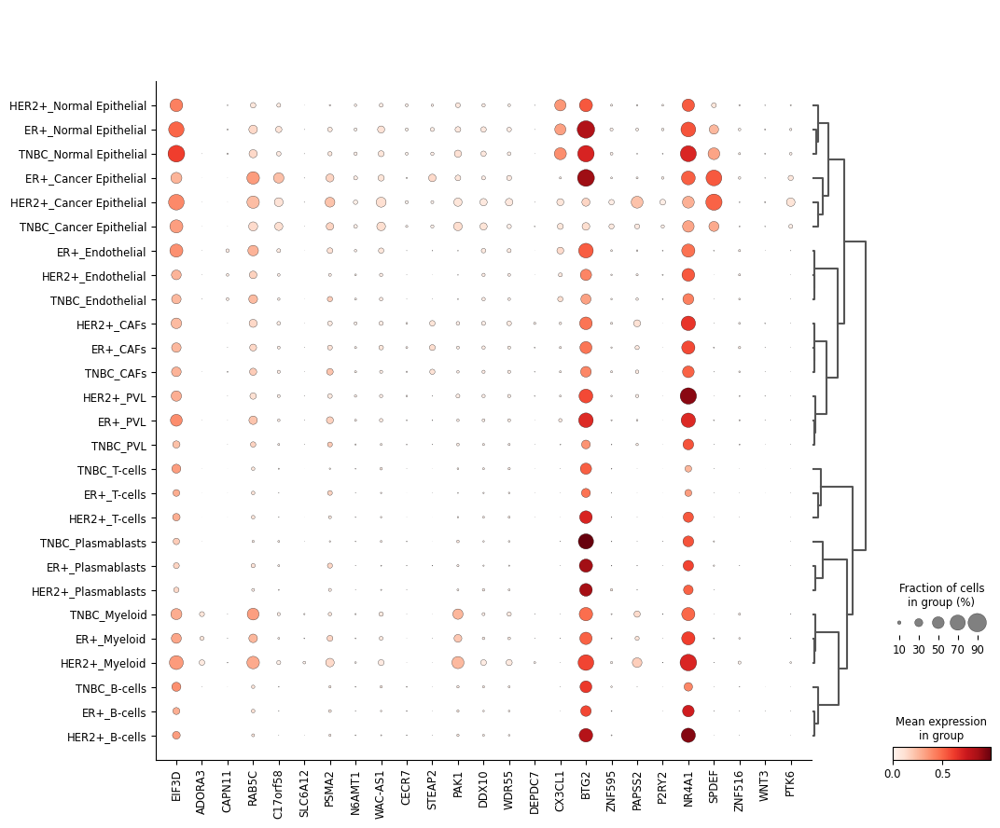

In [ ]:
# 3.3a Breast cancer subtype and cell type investigation
sc.tl.dendrogram(adata, groupby = ["subtype", "Group"])
sc.pl.dendrogram(adata, groupby = ["subtype", "Group"])

sc.pl.dotplot(adata, gene_list_final, groupby=["subtype", "Group"], dendrogram=True,
              save='subtype_cell_type_selected_makers.pdf' )

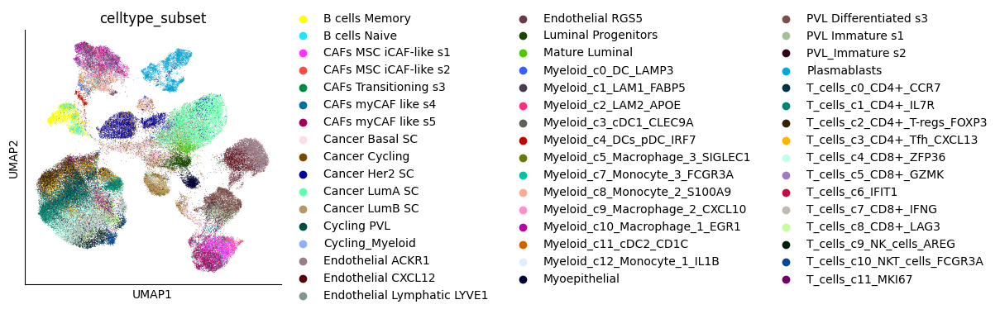

In [ ]:
# 3.4 Breast cancer cell type subset clustering
sc.pl.umap(adata, color=['celltype_subset'], save='Final_cell_type_all.pnj')

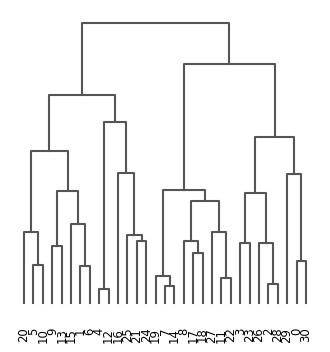

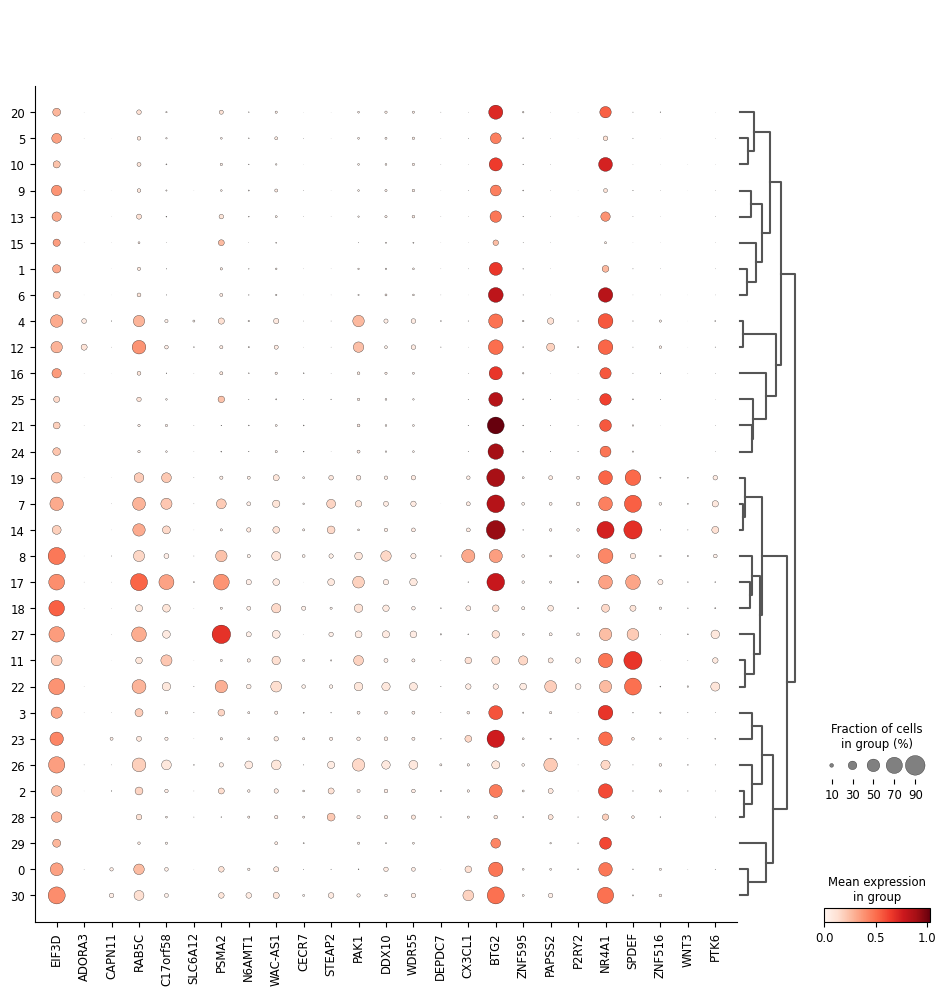

In [ ]:
# 3.5 Leiden clustering investigation (Optional - good when do not have cell annotation)
sc.tl.dendrogram(adata, groupby = "leiden")
sc.pl.dendrogram(adata, groupby = "leiden")

sc.pl.dotplot(adata, gene_list_final, groupby='leiden', dendrogram=True)

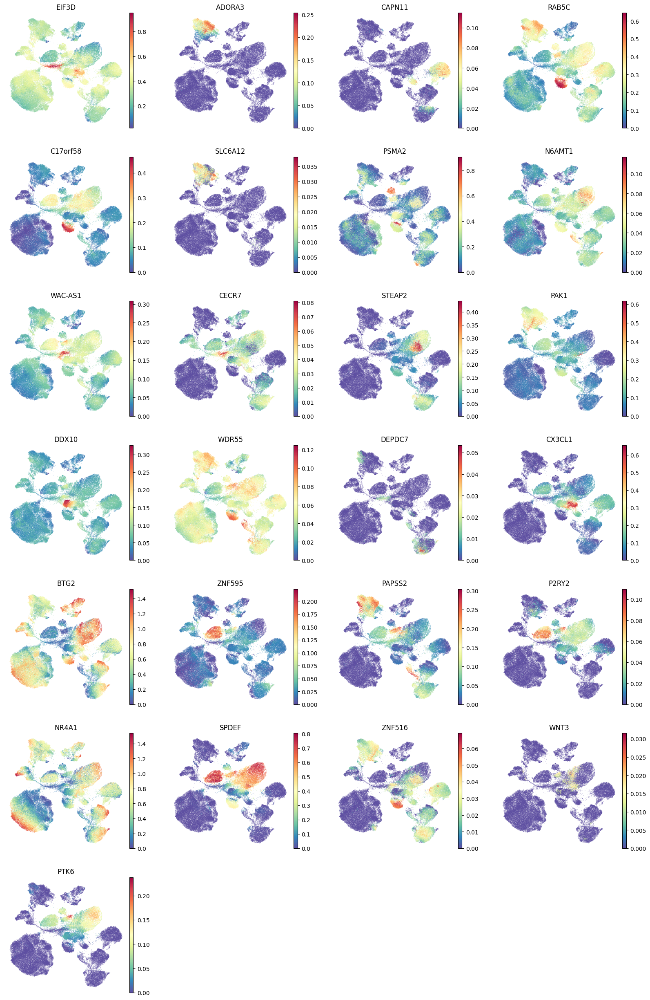

In [ ]:
# 3.6 Biomarker visualisation
# Run diffusion maps
# This step will require more RAM and take a while (2-5 min). To speed up, the user can select
# denoise =False


def marker_investigate (investgated_gene_list=gene_list_final, denoise= True):
    if denoise == True:
        dm_res = palantir.utils.run_diffusion_maps(adata, n_components=15)
        ms_data = palantir.utils.determine_multiscale_space(adata)
        imputed_X = palantir.utils.run_magic_imputation(adata)
        # Visualise
        sc.pl.embedding(
        adata,
        basis="umap",
        layer="MAGIC_imputed_data",
        color= investgated_gene_list,
        save=f"biomarker_investigation_denoise_{denoise}.png",
        frameon=False,
    )
        plt.show()
    else:
        # Visualise
        sc.pl.embedding(
        adata,
        basis="umap",
        color= investgated_gene_list,
        save="biomarker_investigation.png",
        frameon=False,
    )
        plt.show()


# Visualise:
# We can also specify a few genes to investigate here
marker_investigate(investgated_gene_list= gene_list_final,
                   denoise=denoise)


In [ ]:
#  We can also customise the analysis on MAGIC imputation layer
# For example
# sc.pl.dotplot(adata, gene_list_final, groupby='Group',
#                  cmap="RdBu_r",
#                  dendrogram=True,
#                  standard_scale="var",
#                  layer="MAGIC_imputed_data",
#                 save=path+"DE_marker_magic.pdf"
#                  )

In [ ]:
# Save preprocess model
# adata.write_h5ad(path+'Preprocessed_data/FinaL_sc_preprocessed_magic.h5ad')

<h3> Step 4: DE analysis </h3>

For DGE analysis we have to run on normalized values. In case you have raw counts in the matrix you also have to renormalize and logtransform.



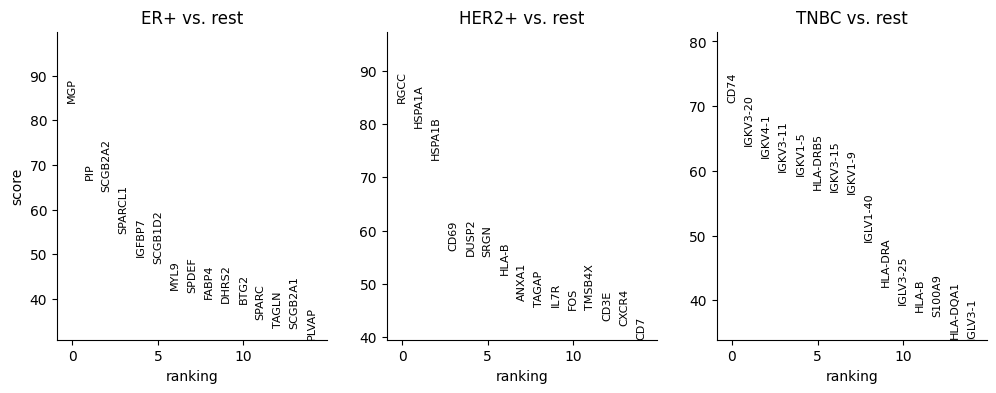

categories: B-cells, CAFs, Cancer Epithelial, etc.
var_group_labels: ER+, HER2+, TNBC


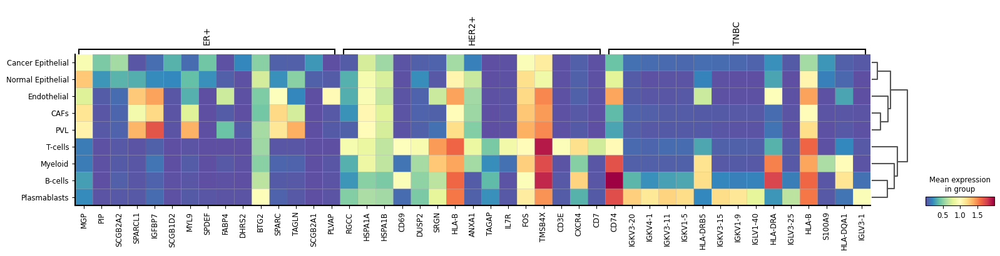

In [ ]:
"""Step 4.1 Breast cancer subtype DE analysis """
key_method = f"{de_method}_subtype"

sc.tl.rank_genes_groups(adata, 'subtype', method=de_method, key_added = key_method)
sc.pl.rank_genes_groups(adata, n_genes=de_genes_visualise, sharey=False, key=key_method,
                        save =f"{de_method}_test_subtype.pdf")
sc.pl.rank_genes_groups_matrixplot(adata, n_genes=de_genes_visualise, key=key_method,
                                    groupby="Group", cmap="Spectral_r",
                                   save =f"{de_method}_test_subtype_cell_type.pdf"  )

In [ ]:
# We can also extract the results to csv for further analysis
results = adata.uns['wilcoxon_subtype']
('0', '1', '2', '3', '4')

out = np.array([[0,0,0,0,0]])
for group in results['names'].dtype.names:
    out = np.vstack((out, np.vstack((results['names'][group],
                                     results['scores'][group],
                                     results['pvals_adj'][group],
                                     results['logfoldchanges'][group],
                                     np.array([group] * len(results['names'][group])).astype('object'))).T))



markers = pd.DataFrame(out[1:], columns = ['Gene', 'scores', 'pval_adj', 'lfc', 'cluster'])

# markers = markers[(markers.pval_adj < 0.05) & (abs(markers.lfc) > 1)]
markers = markers[(markers.pval_adj < 0.05)]
# Save All DE list
markers.to_csv(path+"FC_all_DE_sc.csv")
# Save the investigated markers
markers.query('Gene in@gene_list').to_csv(path+"FC_DE_key_marker_sc.csv")


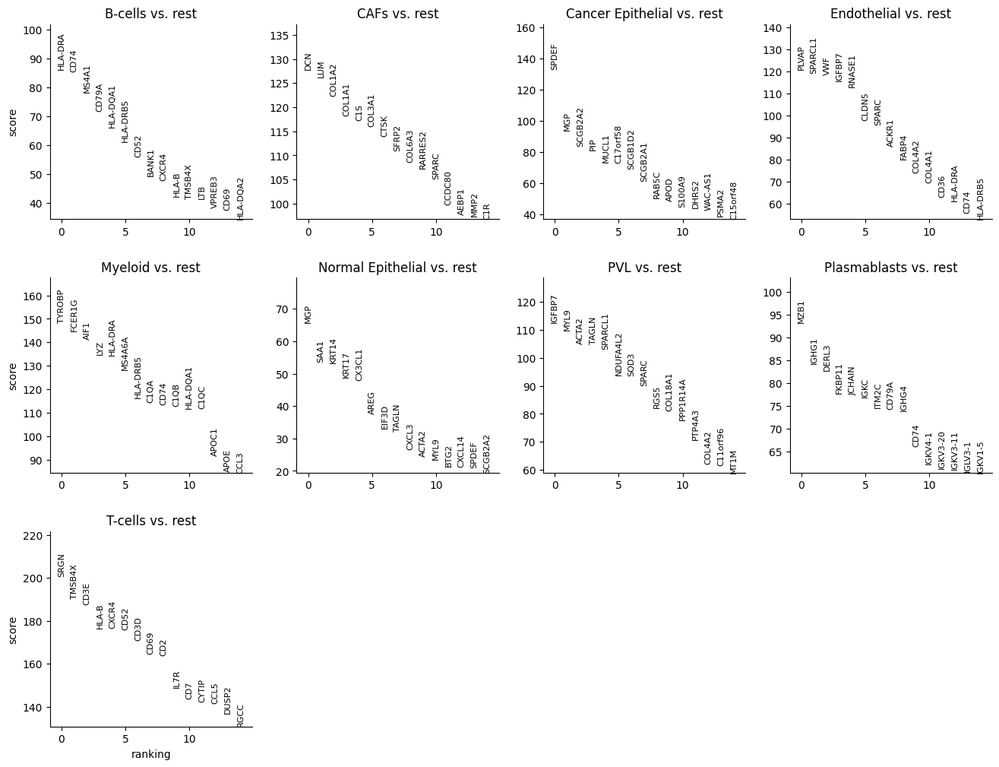

In [ ]:
"""Step 4.2 Cell type DE analysis """
key_method_cell = f"{de_method}_cell_type"

sc.tl.rank_genes_groups(adata, 'Group', method='wilcoxon', key_added = key_method_cell)
sc.pl.rank_genes_groups(adata, n_genes=de_genes_visualise, sharey=False,
                        key=key_method_cell,
                        save =f"{key_method_cell}.pdf")



In [ ]:
# We can also extract the results to csv for further analysis
results = adata.uns['wilcoxon_cell_type']
('0', '1', '2', '3', '4')

out = np.array([[0,0,0,0,0]])
for group in results['names'].dtype.names:
    out = np.vstack((out, np.vstack((results['names'][group],
                                     results['scores'][group],
                                     results['pvals_adj'][group],
                                     results['logfoldchanges'][group],
                                     np.array([group] * len(results['names'][group])).astype('object'))).T))



markers = pd.DataFrame(out[1:], columns = ['Gene', 'scores', 'pval_adj', 'lfc', 'cluster'])

# markers = markers[(markers.pval_adj < 0.05) & (abs(markers.lfc) > 1)]
markers = markers[(markers.pval_adj < 0.05) ]

# Save All DE list
markers.to_csv(path+"Preprocessed_data/FC_all_DE_cell_type.csv")
# Save the investigated markers
df_plot = markers.query('Gene in@gene_list')
df_plot.to_csv(path+"Preprocessed_data/FC_DE_key_marker_cell_type.csv")

Note (Optional step): We will need annotate the gene and cell-type. We can apply the pre- knowledge to match gene and cell-type or based on the p-values and fold change values to annotate (Select the cell-type associated with the smallest p-values and largest fc values)

Once the associated cell types decided, we created a dictionary to map cell types and genes.

categories: B-cells, CAFs, Cancer Epithelial, etc.
var_group_labels: T-cell, Endothelial, Cancer Epithelial, etc.


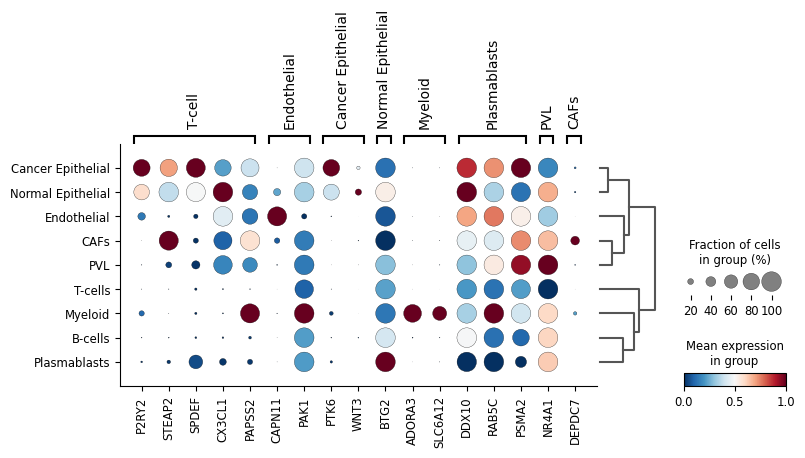

In [ ]:
# 4.2.a (Optional) mapping cell type
marker_genes_dict_cell = {
    "T-cell": ["P2RY2", "STEAP2", "SPDEF", "CX3CL1", "PAPSS2"],
    "Endothelial": ["CAPN11", "PAK1"],
    "Cancer Epithelial": ["PTK6", "WNT3"],
    "Normal Epithelial": ["BTG2"],
    "Myeloid": ["ADORA3", "SLC6A12"],
    "Plasmablasts": ["DDX10", "RAB5C", "PSMA2"],
    "PVL": ["NR4A1"],
    "CAFs": ["DEPDC7"]
}

# If imputation was performed, the user can choose to investigate normal normalised layer
# or imputed layer
sc.pl.dotplot(adata, marker_genes_dict_cell, groupby='Group',
                 cmap="RdBu_r",
                 dendrogram=True,
                 standard_scale="var",
                 layer="MAGIC_imputed_data",  # comment this line to investigate on normalised layer
                save="DE_marker_cell_type.pdf"
                 )

<h3> <b> Section II: Spatial transcriptomic analysis </b> </h3>


In [ ]:
"""Step 5 Import and preprocess spatial transcriptomics"""
# Step 5.1 Import spatial
adata_spatial = sc.read_visium(path+'Spatial_738811QB')

# Important of the sample
print(adata_spatial)

# Spatial info
adata_spatial.obsm['spatial']

AnnData object with n_obs × n_vars = 2518 × 17943
    obs: 'in_tissue', 'array_row', 'array_col'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'


C:\Users\Le\AppData\Roaming\Python\Python310\site-packages\anndata\_core\anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\Le\AppData\Roaming\Python\Python310\site-packages\anndata\_core\anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


array([[19934, 16265],
       [ 7893, 18526],
       [18782,  7178],
       ...,
       [11229, 18277],
       [ 9488, 18780],
       [ 9056, 14994]], dtype=int64)

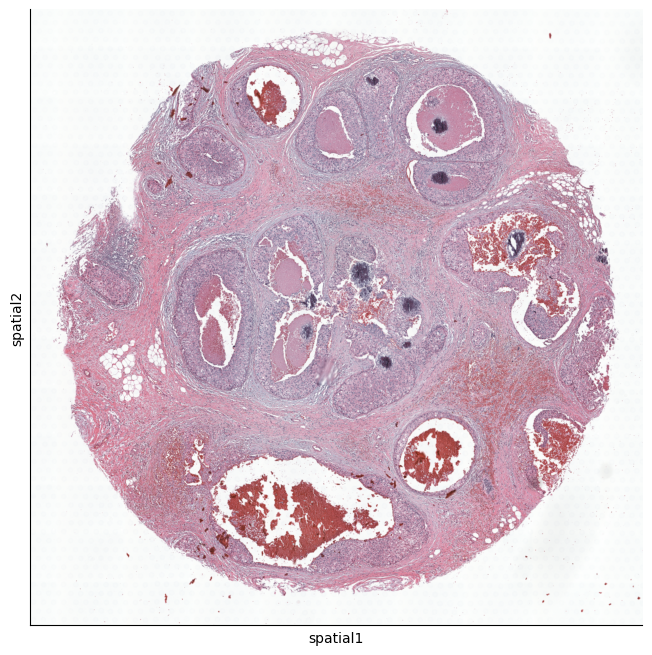

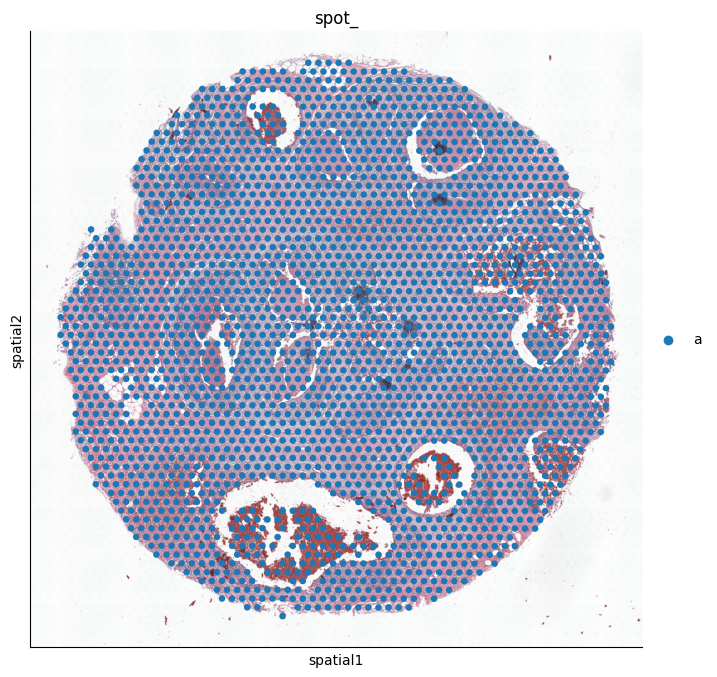

In [ ]:
# Step 5.2 Visualise sample
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(adata_spatial, save="tissue_image.pnj")

# Visualise spot
adata_spatial.obs['spot_'] = 'a'
sc.pl.spatial(adata_spatial, color = 'spot_', save="tissue_image_spot.pnj")


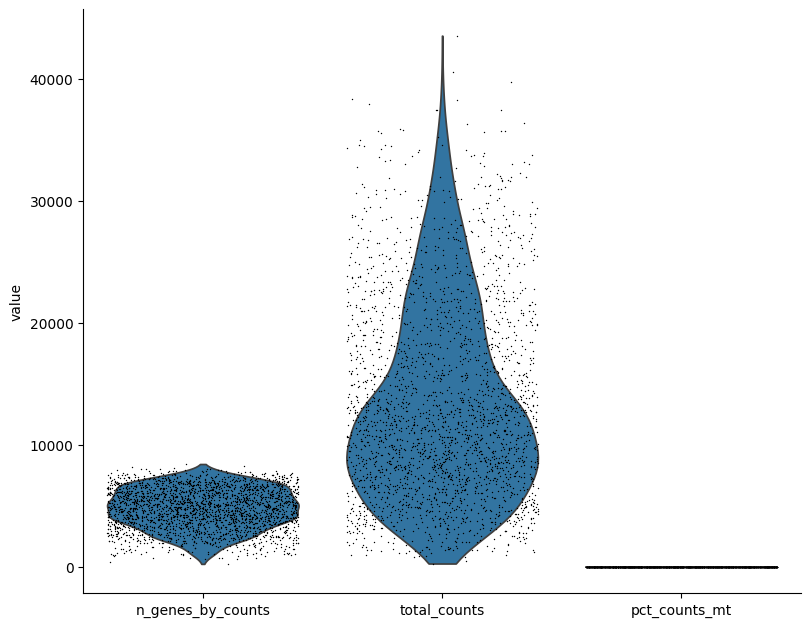

C:\Users\Le\AppData\Local\Temp\ipykernel_37128\3164635651.py:13: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(adata_spatial.obs["total_counts"], kde=False, ax=axs[0])
C:\Users\Le\AppData\Local\Temp\ipykernel_37128\3164635651.py:14: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(adata_spatial.obs

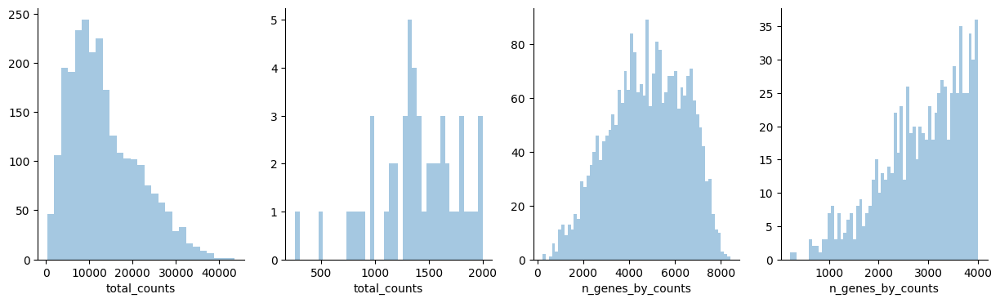

In [ ]:
# Step 5.3 Preprocess spatial data
# Please note the step of quality control and preprocessing are the same as single-cell

# MT read + QC metrics
adata_spatial.var["mt"] = adata_spatial.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(adata_spatial, qc_vars=["mt"], inplace=True)

adata_spatial.var_names_make_unique()
sc.pl.violin(adata_spatial, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt' ], jitter=0.4)

# We can adjust the number of filter genes and cells based on the data
fig, axs = plt.subplots(1, 4, figsize=(15, 4))
sns.distplot(adata_spatial.obs["total_counts"], kde=False, ax=axs[0])
sns.distplot(adata_spatial.obs["total_counts"][adata_spatial.obs["total_counts"] < 2000], kde=False, bins=40, ax=axs[1])
sns.distplot(adata_spatial.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[2])
sns.distplot(adata_spatial.obs["n_genes_by_counts"][adata_spatial.obs["n_genes_by_counts"] < 4000], kde=False, bins=60, ax=axs[3])

plt.show()

2516


C:\Users\Le\AppData\Roaming\Python\Python310\site-packages\scanpy\preprocessing\_simple.py:282: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var["n_cells"] = number


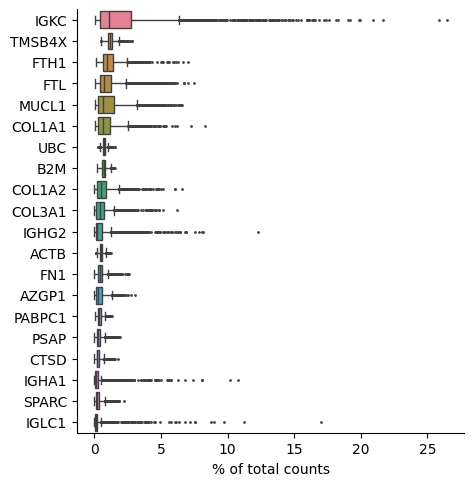

In [ ]:
# Based on the above QC to determine
keep = (adata_spatial.obs['pct_counts_mt'] < 20) & (adata_spatial.obs['n_genes_by_counts'] > 500)
print(sum(keep))

adata_spatial = adata_spatial[keep,:]
# Column
sc.pp.filter_genes(adata_spatial, min_cells=3)
sc.pp.filter_cells(adata_spatial, min_counts = 1000)

#  We can also visualise the top expressed gene in the data (Optional)
sc.pl.highest_expr_genes(adata_spatial, n_top=20)

In [ ]:
# Step 5.3 Preprocess spatial data (cont)
# save the counts to a separate object for later in case we might need to use raw count
#  Or we can save it in a count layer as in the above sc_RNA analysis
counts_adata = adata_spatial.copy()
sc.pp.normalize_total(adata_spatial, inplace=True)
sc.pp.log1p(adata_spatial)

#  We can select 500 HVG for sc_RNA analysis,
#  but for later step - deconvolution spatial data, selecting 1000 -1500 HVG will have more accurate results
sc.pp.highly_variable_genes(adata_spatial, flavor="seurat", n_top_genes=1500, inplace=True)
# adata_spatial= adata_spatial[:,adata_spatial.var.highly_variable == True]

# subset for variable genes
adata_spatial.raw = adata_spatial
# adata = adata[:,adata.var.highly_variable_nbatches > 0]

# scale data
sc.pp.scale(adata_spatial)

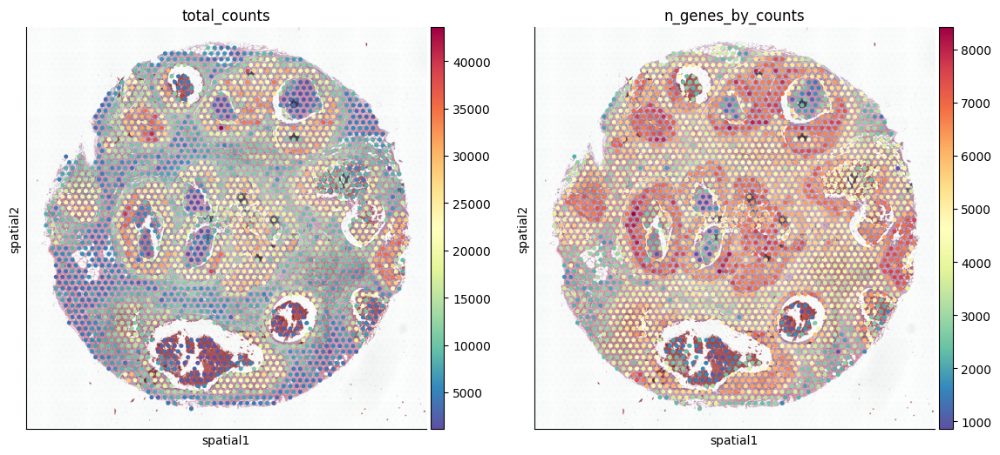

In [ ]:
# Visual on spot
plt.rcParams["figure.figsize"] = (6, 6)
sc.pl.spatial(adata_spatial, img_key="hires", color=["total_counts", "n_genes_by_counts"],
              save="total_count_tissue.png")

<h3> Step 6 Markers analysis on spatial transcriptomics

Epoch 1/150:   0%|          | 0/150 [05:41<?, ?it/s]


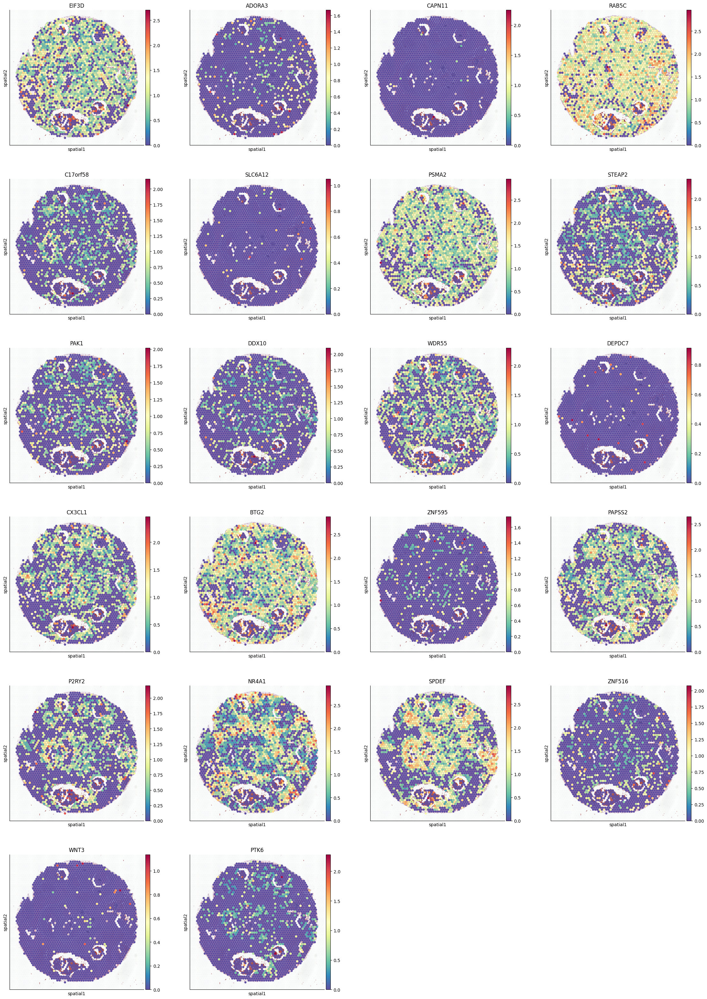

In [ ]:
"""Step 6 Markers analysis on spatial transcriptomics"""

# We can redefined our markers list, the pipeline can dynamically get the marker genes list
# marker_gene= ["P2RY2", "STEAP2", "SPDEF", "CX3CL1", "PAPSS2",
#               "CAPN11", "PAK1", "PTK6", "WNT3", "BTG2",
#               "ADORA3", "SLC6A12", "DDX10", "RAB5C", "PSMA2",
#               "NR4A1", "DEPDC7"]

marker_gene = set(adata_spatial.var.index) & set(gene_list)

# 6.1 Visualise markers
# It might take a while (3-5 mins) depends on the number of markers to visualise
sc.pl.spatial(adata_spatial, img_key="hires", color=marker_gene,cmap= "Spectral_r",
               size=1.5,save="BC_biomarker_spatial.png")

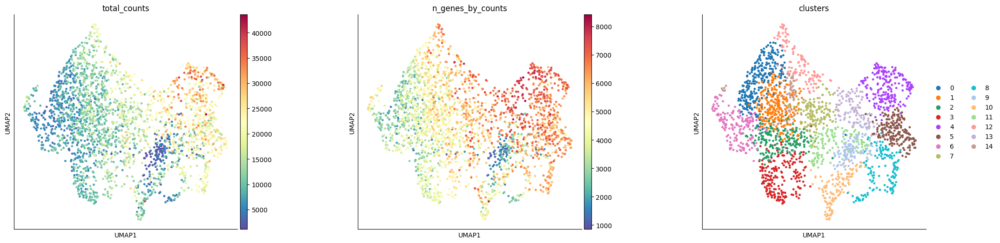

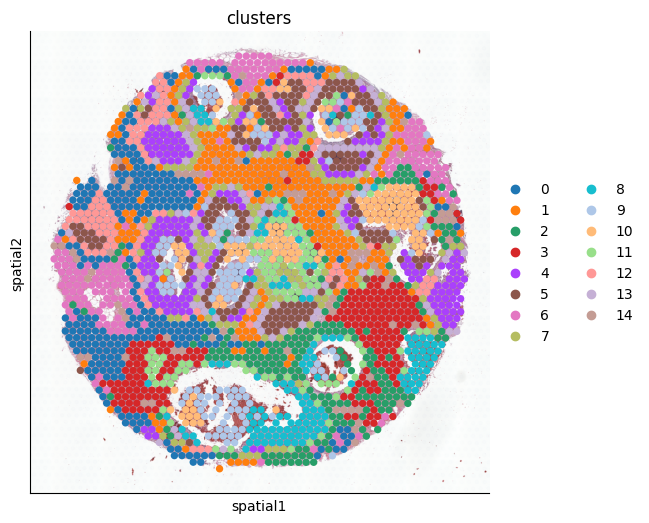

In [ ]:
# 6.2 Dimensionality reduction and clustering
sc.pp.pca(adata_spatial)
sc.pp.neighbors(adata_spatial)
sc.tl.umap(adata_spatial)
sc.tl.leiden(adata_spatial, key_added="clusters", random_state=RANDOM_STATE)


# Visulise cluster
plt.rcParams["figure.figsize"] = (6, 6)
sc.pl.umap(adata_spatial, color=["total_counts", "n_genes_by_counts", "clusters"], wspace=0.4,
           save="leiden_cluster.png")


sc.pl.spatial(adata_spatial, img_key="hires", color="clusters", size=1.5,
              save="leiden_spot_tissue.png")

In [ ]:
adata_spatial

AnnData object with n_obs × n_vars = 2509 × 16783
    obs: 'in_tissue', 'array_row', 'array_col', 'spot_', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'clusters'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'spatial', 'spot__colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'clusters', 'clusters_colors'
    obsm: 'spatial', 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

categories: 0, 1, 2, etc.
var_group_labels: 5


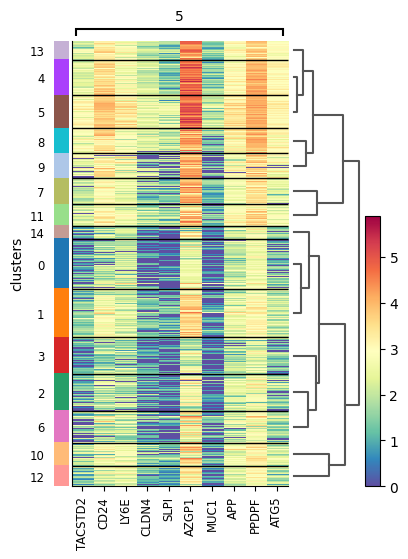

In [ ]:
# 6.3 Spatially Variable Features
# Similarly to sc_RNA, we will run DE analysis,
# In case cell-type are known, DE analysis will be performed for cell type,
# Otherwise, we will based on calculated cluster
key_method_cluster = f"{de_method}_clusters"

sc.tl.rank_genes_groups(adata_spatial, "clusters", method=de_method)

# # plot as heatmap for cluster5 genes
# # 6.3.a We can analysis the DE genes in a specific cluster (e.g., group 5)
cluster_num = "5"
sc.pl.rank_genes_groups_heatmap(adata_spatial, groups="5", n_genes=10, groupby="clusters",
                                save=f"leiden_DE_cluster_{cluster_num}.png")

In [ ]:
# Extract all DE genes (pvalue <0.05) for later analysis (optional)
cluster_list =adata_spatial.obs['clusters'].unique()
for i in cluster_list:
    pd.DataFrame(sc.get.rank_genes_groups_df(
        adata_spatial, group=i,pval_cutoff=0.05)['names']).to_csv(
            path+f"Preprocessed_data/DE_cluster_{i}.csv")

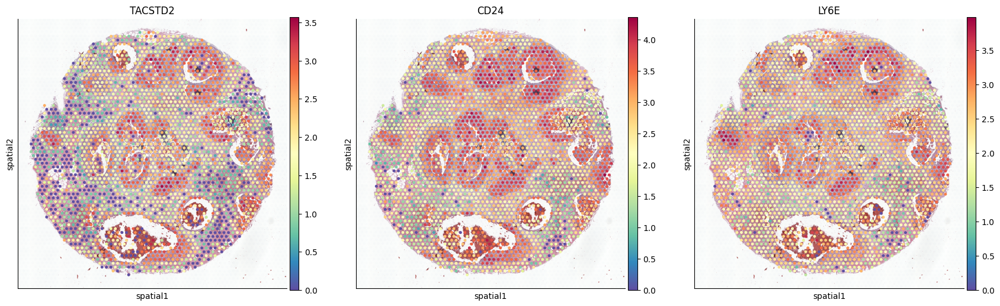

In [ ]:
# 6.3.b Visualise onto spatial location
# log2fc_min=0
top_genes = sc.get.rank_genes_groups_df(adata_spatial, group=cluster_num,pval_cutoff=0.05)['names'][:3]
sc.pl.spatial(adata_spatial, color = top_genes, save=f"Spatial_DE_cluster_{cluster_num}.png")

<h3> Step 7 Spatial transcriptomics deconvolution </h3>

Spatial transcriptomcis will be deconvoluted based on single-cell data
The single-cell has to be raw counts. We can either (1) retrieve the raw counts layer (counts) from section I - sc-RNA analysis or import a new single-cell raw counts

Also, the algorithm may take time, so we will sample to 500 cells per cell type and DE genes with min fc = 1 to boot the process

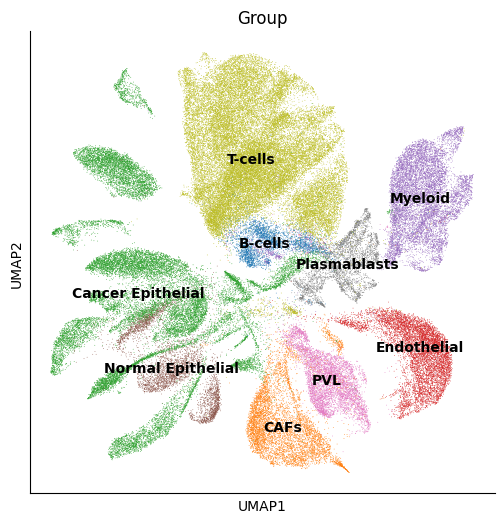

In [ ]:
"""Step 7 Spatial transcriptomics deconvolution"""

# 7.1 If you are using new single-cell data, preprocessing steps has to done again
# Using data from section 1
# adata_sc = adata.copy()
# adata_sc.X =adata_sc.layers['counts']  # Overwrite X matrics with raw counts


# To have a refresh start, we will import the new proprocessed data with 1000 HVG
adata_sc = sc.read_h5ad(path+'Preprocessed_data/sc_spatial_deconvolution.h5ad')

# save normalized counts in raw slot.
adata_sc.raw = adata_sc
# normalize to depth 10 000
sc.pp.normalize_per_cell(adata_sc, counts_per_cell_after=1e4)
# logaritmize
sc.pp.log1p(adata_sc)
# scale
sc.pp.scale(adata_sc)

# PCA
sc.tl.pca(adata_sc)
sc.pp.neighbors(adata_sc, n_pcs=20)
sc.tl.umap(adata_sc)
sc.pl.umap(adata_sc, color="Group", legend_loc='on data')

# Overwrite count layer (important step)
adata_sc.X =adata_sc.layers['counts']

Group
B-cells              500
CAFs                 500
Cancer Epithelial    500
Endothelial          500
Myeloid              500
Normal Epithelial    500
PVL                  500
Plasmablasts         500
T-cells              500
Name: count, dtype: int64


C:\Users\Le\AppData\Local\Temp\ipykernel_37128\78056955.py:11: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_sc_new= adatas2[0].concatenate(*adatas2[1:])


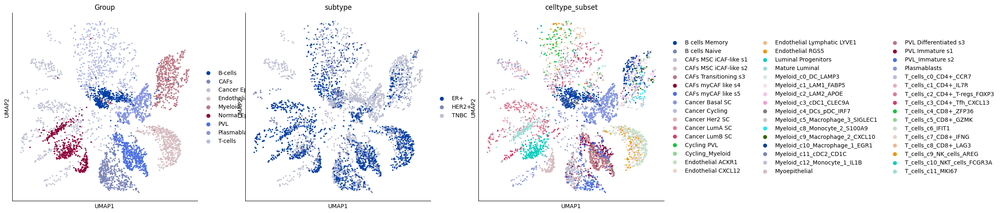

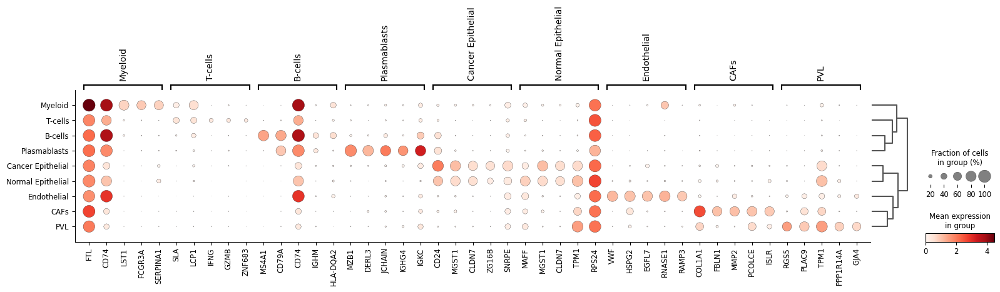

       group     names     scores  logfoldchanges          pvals  \
0    B-cells     MS4A1  30.097898       11.358714  5.161946e-199   
1    B-cells     CD79A  25.039293        4.392213  2.283685e-138   
2    B-cells      CD74  20.260489       12.891562   2.870951e-91   
3    B-cells      IGHM  10.923660       -0.663875   8.884157e-28   
4    B-cells  HLA-DQA2  10.913328        1.440226   9.954419e-28   
..       ...       ...        ...             ...            ...   
895  T-cells   TRBV4-2   0.383619        3.699032   7.012610e-01   
896  T-cells  TRAV38-1   0.365108       23.943125   7.150309e-01   
897  T-cells   TRBV5-5   0.356017        7.022959   7.218281e-01   
898  T-cells   TRAV1-1   0.346889        5.011193   7.286748e-01   
899  T-cells     RPS26   0.341230       -2.820799   7.329306e-01   

         pvals_adj  
0    4.991601e-196  
1    1.104161e-135  
2     6.940523e-89  
3     4.772766e-26  
4     5.066275e-26  
..             ...  
895   8.332956e-01  
896   8.442429e

In [ ]:
# 7.2 Sampling cells in each cell type to speed up the process

target_cells = 500

adatas2 = [adata_sc[adata_sc.obs.Group == clust] for clust in adata_sc.obs.Group.cat.categories]

for dat in adatas2:
    if dat.n_obs > target_cells:
          sc.pp.subsample(dat, n_obs=target_cells)

adata_sc_new= adatas2[0].concatenate(*adatas2[1:])

print(adata_sc_new.obs.Group.value_counts())

# Check new UMAP

sc.pl.umap(
    adata_sc_new, color=["Group", "subtype", "celltype_subset"], palette=sc.pl.palettes.default_28)

# DE analysis
sc.tl.rank_genes_groups(adata_sc_new, 'Group', method = "wilcoxon", n_genes=100, use_raw=False)
sc.pl.rank_genes_groups_dotplot(adata_sc_new, n_genes=5)


sc.tl.filter_rank_genes_groups(adata_sc_new, min_fold_change=1)

genes = sc.get.rank_genes_groups_df(adata_sc_new, group = None)
print(genes)


In [ ]:
# Get DE genes
deg = genes.names.unique().tolist()
print(len(deg))

# check that the genes are also present in the spatial data
deg = np.intersect1d(deg,adata_spatial.var.index).tolist()
print(len(deg))

605
457


Trainer will use only 1 of 2 GPUs because it is running inside an interactive / notebook environment. You may try to set `Trainer(devices=2)` but please note that multi-GPU inside interactive / notebook environments is considered experimental and unstable. Your mileage may vary.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
C:\Users\Le\AppData\Roaming\Python\Python310\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.


Epoch 150/150: 100%|██████████| 150/150 [00:18<00:00,  8.17it/s, v_num=1, train_loss_step=8.89e+3, train_loss_epoch=4.51e+4]

`Trainer.fit` stopped: `max_epochs=150` reached.


Epoch 150/150: 100%|██████████| 150/150 [00:18<00:00,  8.04it/s, v_num=1, train_loss_step=8.89e+3, train_loss_epoch=4.51e+4]


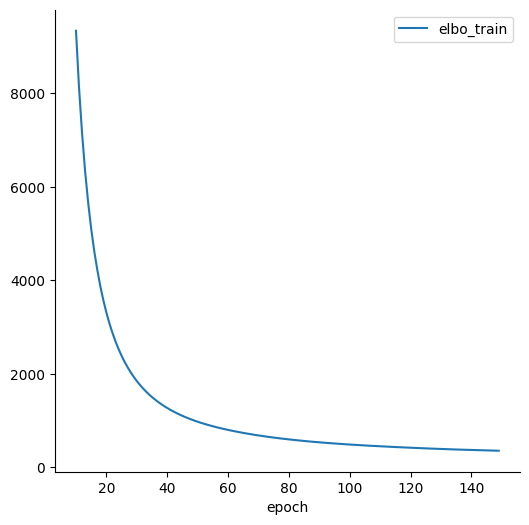

In [ ]:
# 7.3 Define and train model to predict proportional spatial/ decovolute
# 7.3.a Single-cell part


sc_adata = adata_sc_new.copy()
sc_adata.X = adata_sc_new.raw.X.copy()


# add counts layer
# sc_adata.layers["counts"] = sc_adata.X.copy()

# subset for the selected genes
sc_adata = sc_adata[:, deg].copy()

# create stereoscope object
RNAStereoscope.setup_anndata(sc_adata, layer="counts", labels_key="Group")

# Define the model
train = True
if train:
    sc_model = RNAStereoscope(sc_adata)
    sc_model.train(max_epochs=150)
    sc_model.history["elbo_train"][10:].plot()
    sc_model.save("./data/spatial/visium/scanpy_scmodel", overwrite=True)
else:
    sc_model = RNAStereoscope.load("./data/spatial/visium/scanpy_scmodel", sc_adata)
    print("Loaded RNA model from file!")

Trainer will use only 1 of 2 GPUs because it is running inside an interactive / notebook environment. You may try to set `Trainer(devices=2)` but please note that multi-GPU inside interactive / notebook environments is considered experimental and unstable. Your mileage may vary.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
C:\Users\Le\AppData\Roaming\Python\Python310\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.


Epoch 1000/1000: 100%|██████████| 1000/1000 [01:18<00:00, 13.63it/s, v_num=1, train_loss_step=1.26e+6, train_loss_epoch=1.24e+6]

`Trainer.fit` stopped: `max_epochs=1000` reached.


Epoch 1000/1000: 100%|██████████| 1000/1000 [01:18<00:00, 12.75it/s, v_num=1, train_loss_step=1.26e+6, train_loss_epoch=1.24e+6]


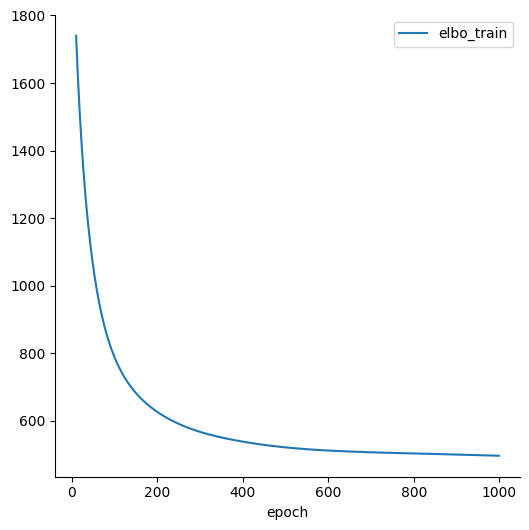

In [ ]:
# 7.3.b Spatial transcriptomic part

st_adata = adata_spatial.copy()

st_adata.layers["counts"] = counts_adata.X.copy()
st_adata = st_adata[:, deg].copy()

SpatialStereoscope.setup_anndata(st_adata, layer="counts")

# Deconvolution model
train = True
if train:
    spatial_model = SpatialStereoscope.from_rna_model(st_adata, sc_model)
    spatial_model.train(max_epochs = 1000)
    # spatial_model.train(max_epochs = 3000)  # recommended epoch
    spatial_model.history["elbo_train"][10:].plot()
    spatial_model.save("./data/spatial/visium/scanpy_stmodel", overwrite = True)
else:
    spatial_model = SpatialStereoscope.load("./data/spatial/visium/scanpy_stmodel", st_adata)
    print("Loaded Spatial model from file!")

In [ ]:
# Deconvolution results
st_adata.obsm["deconvolution"] = spatial_model.get_proportions()

# Update spatial object
for ct in st_adata.obsm["deconvolution"].columns:
    st_adata.obs[ct] = st_adata.obsm["deconvolution"][ct]

Epoch 1/150:   0%|          | 0/150 [05:08<?, ?it/s]


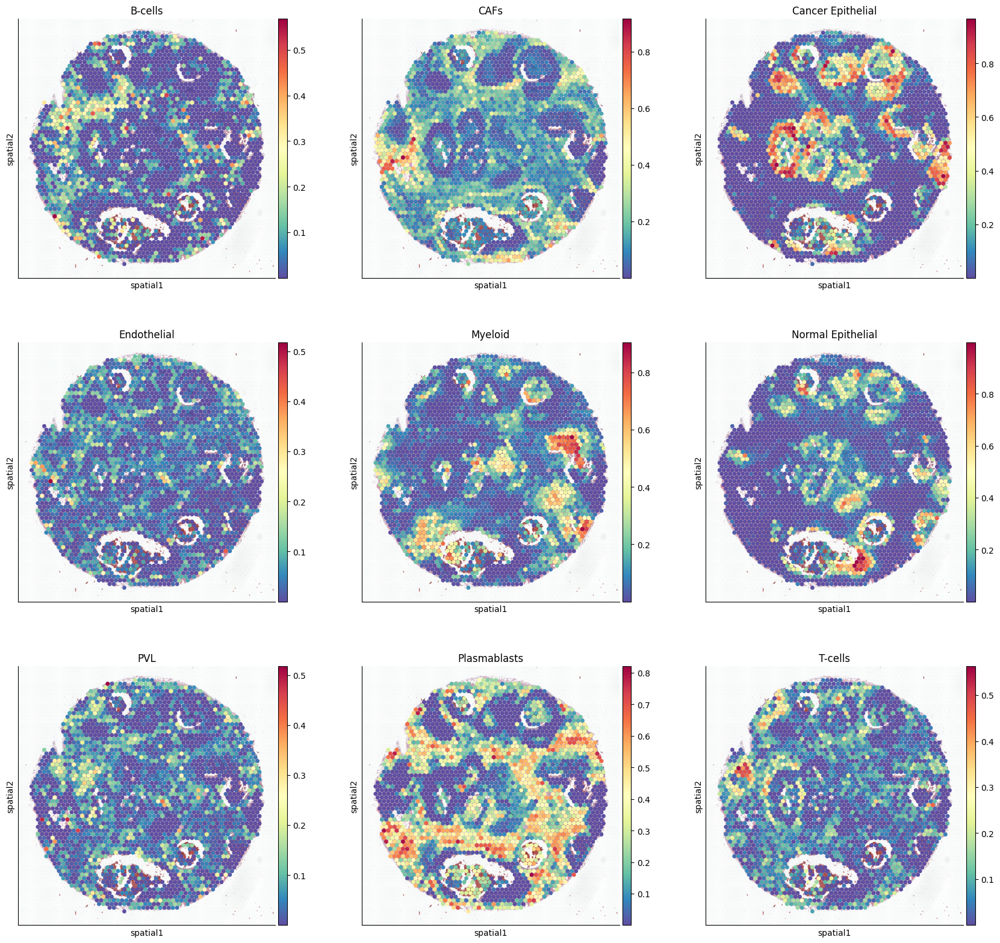

In [ ]:
# 7.4.a Visualise cell type on spatial
sc.pl.spatial(
    st_adata,
    img_key="hires",
    color=['B-cells', 'CAFs', 'Cancer Epithelial', 'Endothelial', 'Myeloid',
       'Normal Epithelial', 'PVL', 'Plasmablasts', 'T-cells'],
    size=1.5,
    ncols=3,
    save="cell_type_deconcolution_spatial.pnj"
)

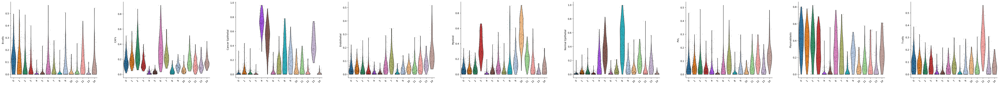

In [ ]:
# 7.4 Visualise
sc.pl.violin(st_adata, ['B-cells', 'CAFs', 'Cancer Epithelial', 'Endothelial', 'Myeloid',
       'Normal Epithelial', 'PVL', 'Plasmablasts', 'T-cells'],
            jitter=0.4, groupby = 'clusters', rotation= 45,
            save="cell_type_deconcolution_cluster.pnj")